# Time series manipulation and visualization

In the last notebook, we saw how to fetch metrics from a prometheus instance using the prometheus api client. In this notebook, we will learn how to manipulate and visualize the fetched time series data.
* As an example, we take "node_memory_Active_bytes" which are the memory bytes that have been recently used by a node. It reflects the memory pressure on the node.
* In the following cells, we show how to perform basic operations on this time series and then how to descriptively visualize them in graphs.

In [1]:
from prometheus_api_client import PrometheusConnect
from prometheus_api_client.metric_range_df import MetricRangeDataFrame
from prometheus_api_client.utils import parse_datetime
from datetime import timedelta
import pandas as pd
from IPython.display import Image
import plotly.graph_objects as go

## Fetch the metric data
* We extract "node_memory_Active_bytes" for the last 7 days.

In [3]:
# Creating the prometheus connect object with the required parameter
prom_url = "http://demo.robustperception.io:9090"
pc = PrometheusConnect(url=prom_url, disable_ssl=True)

# Request last week's data
metric_data = pc.get_metric_range_data(
    "node_memory_Active_bytes",  # metric name and label config
    start_time=parse_datetime(
        "7 days ago"
    ),  # datetime object for metric range start time
    end_time=parse_datetime(
        "now"
    ),  # datetime object for metric range end time
    chunk_size=timedelta(
        days=1
    ),  # timedelta object for duration of metric data downloaded in one request
)

## Make the dataframe
metric_df = MetricRangeDataFrame(metric_data)
metric_df.index = pd.to_datetime(metric_df.index, unit="s", utc=True)

## Visualization
* For visualization, we are going to use plotly interactive plots.
* The next graph shows active bytes in the node for the week.
* We can interatively zoom in and zoom out the graph. Try selecting a time frame to zoom in.

In [4]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=metric_df.index, y=metric_df["value"]))
fig.update_layout(
    title="Node memory active bytes", xaxis_title="Time", yaxis_title="Bytes"
)

* Sometimes the data is huge, and since interactive plots show each point in the graph, it can take a while to load.
* To solve that problem you can try two things: plot static graph or downsample (both explained next).

### Static plot

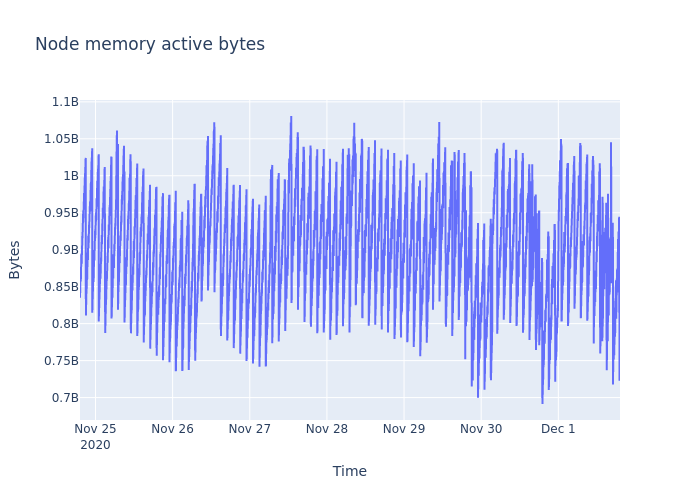

In [5]:
## The way to generate static images
img_bytes = fig.to_image(format="png")
Image(img_bytes)

## Data Manipulation

### Indexing
* Here we see how to get data for a particular period of time.

In [6]:
# Get data for today
today = str(parse_datetime("now").date())
print("Date today: ", today)
metric_df_td = metric_df.loc[today]
metric_df_td
# You can also do metric_df.loc['2020'] to get all values for the year 2020

Date today:  2020-12-01


,__name__,instance,job,value
timestamp,,,,
2020-12-01 00:00:04.713999987+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,823160832
2020-12-01 00:00:14.710999966+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,831782912
2020-12-01 00:00:24.709000111+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,829698048
2020-12-01 00:00:34.709000111+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,832573440
2020-12-01 00:00:44.713999987+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,851910656
...,...,...,...,...
2020-12-01 19:10:14.723000050+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,751525888
2020-12-01 19:10:24.719000101+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,749457408
2020-12-01 19:10:34.713000059+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,745418752


In [7]:
fig = go.Figure(go.Scatter(x=metric_df_td.index, y=metric_df_td["value"]))
fig.update_layout(title="Indexing", xaxis_title="Time", yaxis_title="Bytes")

### Slicing 
* Here we see how to get data for a range of time.

In [8]:
# Get data for today but only from 6 to 9 PM
# Note the index strings created for slicing
metric_df_slice = metric_df.loc[today + " 18:00" : today + " 21:00"]
metric_df_slice

,__name__,instance,job,value
timestamp,,,,
2020-12-01 18:00:04.720000029+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,814764032
2020-12-01 18:00:14.707999945+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,820936704
2020-12-01 18:00:24.710000038+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,819544064
2020-12-01 18:00:34.709000111+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,816992256
2020-12-01 18:00:44.709000111+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,822444032
...,...,...,...,...
2020-12-01 19:10:14.723000050+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,751525888
2020-12-01 19:10:24.719000101+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,749457408
2020-12-01 19:10:34.713000059+00:00,node_memory_Active_bytes,demo.robustperception.io:9100,node,745418752


In [9]:
fig = go.Figure(
    go.Scatter(x=metric_df_slice.index, y=metric_df_slice["value"])
)
fig.update_layout(title="Slicing", xaxis_title="Time", yaxis_title="Bytes")
fig.show()

* Try getting this same snapshot in the first image by selecting this slice in the interactive plot.

### Resampling
* Resampling is used to get the data in a different time frequency.
* It is very important because certain patterns become apparent only when you resample. For example, you may not observe seasonality in hourly CPU usage data but it may be visible in the weekly data. 

#### Downsampling
* Here we reduce the frequency of sampling. For example, daily data to weekly data.
* The reduction needs an aggregation method.
* Therefore, we have to specify how to reduce: mean, sum, max, etc.
* For specifying frequencies we can use frequency [aliases](https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#timeseries-offset-aliases) like 'D' for day and 'H' for hour.

In [10]:
## Get a pandas time series by type conversion of object to float
ts = metric_df["value"].astype(float)

In [11]:
## Downsample to daily frequency
ts_d = ts.resample("D").mean()
ts_d

timestamp
2020-11-24 00:00:00+00:00    9.185613e+08
2020-11-25 00:00:00+00:00    9.012643e+08
2020-11-26 00:00:00+00:00    8.922400e+08
2020-11-27 00:00:00+00:00    9.007292e+08
2020-11-28 00:00:00+00:00    9.117904e+08
2020-11-29 00:00:00+00:00    8.890380e+08
2020-11-30 00:00:00+00:00    8.733966e+08
2020-12-01 00:00:00+00:00    8.959957e+08
Freq: D, Name: value, dtype: float64

In [12]:
## Downsample to 12 hour frequency
ts_h = ts.resample("12H").mean()
ts_h

timestamp
2020-11-24 12:00:00+00:00    9.185613e+08
2020-11-25 00:00:00+00:00    9.202781e+08
2020-11-25 12:00:00+00:00    8.822504e+08
2020-11-26 00:00:00+00:00    8.836860e+08
2020-11-26 12:00:00+00:00    9.007940e+08
2020-11-27 00:00:00+00:00    8.770550e+08
2020-11-27 12:00:00+00:00    9.244034e+08
2020-11-28 00:00:00+00:00    9.188438e+08
2020-11-28 12:00:00+00:00    9.047370e+08
2020-11-29 00:00:00+00:00    8.980554e+08
2020-11-29 12:00:00+00:00    8.800205e+08
2020-11-30 00:00:00+00:00    8.935159e+08
2020-11-30 12:00:00+00:00    8.532774e+08
2020-12-01 00:00:00+00:00    9.196664e+08
2020-12-01 12:00:00+00:00    8.564529e+08
Freq: 12H, Name: value, dtype: float64

In [13]:
## Downsample to 30 min frequency
ts_30_min = ts.resample("30min").mean()
ts_30_min

timestamp
2020-11-24 19:00:00+00:00    8.559968e+08
2020-11-24 19:30:00+00:00    8.968734e+08
2020-11-24 20:00:00+00:00    9.472048e+08
2020-11-24 20:30:00+00:00    9.978978e+08
2020-11-24 21:00:00+00:00    8.503984e+08
                                 ...     
2020-12-01 17:00:00+00:00    7.545388e+08
2020-12-01 17:30:00+00:00    8.064749e+08
2020-12-01 18:00:00+00:00    8.458119e+08
2020-12-01 18:30:00+00:00    9.000010e+08
2020-12-01 19:00:00+00:00    7.373278e+08
Freq: 30T, Name: value, Length: 337, dtype: float64

In [14]:
## Plot the downsamples
fig = go.Figure()
fig.add_trace(go.Scatter(x=ts.index, y=ts, name="Original"))
fig.add_trace(go.Scatter(x=ts_30_min.index, y=ts_30_min, name="Every 30 mins"))
fig.add_trace(go.Scatter(x=ts_d.index, y=ts_d, name="Daily"))
fig.update_layout(
    title="Resampling",
    xaxis_title="Time",
    yaxis_title="Bytes",
    legend_title="Frequency",
)
fig.show()

### Upsampling
* Upsampling is possible but new information is added to the data in this step since we are converting from low resolution to high resolution, for e.g., weekly data to daily data.
* Upsampling is less common but is used usually when analyzing multiple time series that should have the same frequency of observation.
* The next example shows upsampling with forward fill algorithm (taking the previous valid value for filling missing one).

In [15]:
## Downsample to hourly data and then upsample to min frequency
ts_uh = ts.resample("H").mean().resample("min").ffill()
fig = go.Figure()
fig.add_trace(go.Scatter(x=ts_h.index, y=ts_h, name="Hourly"))
fig.add_trace(go.Scatter(x=ts_uh.index, y=ts_uh, name="Upsampled minutely"))
fig.update_layout(
    title="Uplsampling",
    xaxis_title="Time",
    yaxis_title="Bytes",
    legend_title="Frequency",
)
fig.show()

### Rolling
* Rolling is used to aggreate along a window around a data point.
* A good use of rolling is smoothing the time series.
* For example, here we look at 60 min, and 360 min data window averages of node memory.

In [16]:
ts_min = ts.resample("min").mean()
ts_rm = ts_min.rolling(60, center=True).mean()
ts_rm_ext = ts_min.rolling(360, center=True).mean()

fig = go.Figure()
fig.add_trace(go.Scatter(x=ts_min.index, y=ts_min, name="Original"))
fig.add_trace(go.Scatter(x=ts_rm.index, y=ts_rm, name="60 min mean"))
fig.add_trace(go.Scatter(x=ts_rm_ext.index, y=ts_rm_ext, name="360 min mean"))
fig.update_layout(
    title="Rolling",
    xaxis_title="Time",
    yaxis_title="Bytes",
    legend_title="Rolling mean",
)
fig.show()

### Standard deviation
* For the times when you don't trust mean, here's how to plot the series with standard deviation

In [17]:
ts_min = ts.resample("min").mean()
ts_rm_ext = ts_min.rolling(360, center=True)
ts_rm_mean = ts_rm_ext.mean()
ts_rm_std = ts_rm_ext.std().fillna(0)


fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=ts_rm_mean.index,
        y=ts_rm_mean,
        error_y=dict(
            type="data",
            array=ts_rm_std.values,
            color="lightblue",
            thickness=0.5,
            visible=True,
        ),
    )
)
fig.update_layout(
    title="Standard deviation",
    xaxis_title="Time",
    yaxis_title="Bytes",
)
fig.show()

### Conclusion
* With that, you know the basics of dealing with and plotting time series data. We will be using a lot of these methods over the coming notebooks. Next, we are going into delve into statistics with time series data.

### References

Thanks to the shoulders we stand on.

* https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html
* https://tomaugspurger.github.io/modern-7-timeseries
* https://jakevdp.github.io/PythonDataScienceHandbook/03.11-working-with-time-series.html
